In [1]:
import datetime as dt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import APSIMGraphHelpers as AGH
import GraphHelpers as GH
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
import matplotlib.dates as mdates
import MathsUtilities as MUte
import shlex # package to construct the git command to subprocess format
import subprocess 
import xmltodict, json
import sqlite3
from scipy.optimize import basinhopping
from scipy.optimize import dual_annealing
from skopt import gp_minimize
%matplotlib inline

In [2]:
Colors = {1:'#000000',
2:'#E69F00',
3:'#56B4E9',
4:'#009E73',
5:'#F0E442',
6:'#0072B2',
7:'#D55E00',
8:'#CC79A7',
9:'#1F77B4',
10:'#AEC7E8',
11:'#FF7F0E',
12:'#FFBB78',
13:'#2CA02C',
14:'#98DF8A',
15:'#D62728',
16:'#FF9896',
17:'#9467BD',
18:'#C5B0D5',
19:'#8C564B',
20:'#C49C94',
21:'#E377C2',
22:'#F7B6D2',
23:'#7F7F7F',
24:'#C7C7C7',
25:'#BCBD22',
26:'#DBDB8D',
27:'#17BECF',
28:'#9EDAE5'}

Markers = {1: 'o',
 2: '^',
 3: 's',
 4: '*',
 5: '>',
 6: 'v',
 7: '+',
 8: 'X',
 9: '<',
 10: 'p',
 11: '8',
 12: 'd',
 13:'P',
 14:'D',
 15:'o',
 16:'^'}

Lines = {1: '-',
 2: '--',
 3: '-,',
 4: ':',
 5: '-',
 6: '--',
 7: '-,',
 8: ':',
 9: '-',
 10: '--',
 11: '-,',
 12: ':',
 13: '-',
 14: '--',
 15: '-,',
 16: ':'}

In [3]:
filePath = r'C:\GitHubRepos\ApsimX\Tests\Validation\Wheat\Wheat.db'

In [4]:
VariableRenamesFile = 'C:\GitHubRepos\ApsimX\Prototypes\WheatSimpleLeaf\SimpleLeafImplementation\VariableRenames.xlsx'
VRsheetname =  'SimpleLeafRenames'
VariableRenames = pd.read_excel(VariableRenamesFile,index_col=0, sheet_name='SimpleLeafRenames').to_dict()['SimpleLeaf']

In [5]:
SensibilityFolders = ['CO2AndTranspirationEfficiency',
'CO2AndTemperatureInteractions',
'ProteinAccumulation',
'LeafAppearance',
'TerminalWaterStress',
'DetailedDynamics']

In [6]:
#Set up simulations index table
con = sqlite3.connect(filePath)
Simulations = pd.read_sql("Select * from _Simulations",con)
con.close()
Simulations.set_index('ID',inplace=True)
Simulations.sort_index(inplace=True)
Simulations.sort_index(inplace=True, axis=1)


In [7]:
# read in predicted values output on harvest date
con = sqlite3.connect(filePath)
HarvestPred = pd.read_sql("Select * from HarvestReport",con).dropna(axis=1,how='all')
con.close()
HarvestPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in HarvestPred.SimulationID]
HarvestPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
HarvestPred.sort_index(inplace=True)
HarvestPred.sort_index(inplace=True,axis=1)

# Filter outputs from sensibility tests
validationFilter = [x not in SensibilityFolders for x in HarvestPred.FolderName]
HarvestPred = HarvestPred.loc[validationFilter,:].copy()
HarvestPred.dropna(how='all',axis=1,inplace=True)
HarvestPred.loc[:,'Wheat.SowingData.Cultivar'] = [x.title() for x in HarvestPred.loc[:,'Wheat.SowingData.Cultivar']]
validationFilter = [x not in SensibilityFolders for x in HarvestPred.FolderName]
HarvestPred = HarvestPred.loc[validationFilter,:].copy()
HarvestPred.dropna(how='all',axis=1,inplace=True)

# Replace Experiment with values that have had folder name pathed in where no experiment is present
HarvestPred.loc[[x is None for x in HarvestPred.Experiment],'Experiment'] = HarvestPred.loc[[x is None for x in HarvestPred.Experiment],'FolderName']

In [8]:
Latitudes = list(HarvestPred.loc[:,'IWeather.Latitude'].drop_duplicates().values)
Latitudes.sort()
Longitudes = list(HarvestPred.loc[:,'IWeather.Longitude'].drop_duplicates().values)
Longitudes.sort()
Countries = list(HarvestPred.loc[:,'LocationInfo.Script.Country'].drop_duplicates().values)
Regions = list(HarvestPred.loc[:, 'LocationInfo.Script.Region'].drop_duplicates().values)
States = list(HarvestPred.loc[:,'LocationInfo.Script.State'].drop_duplicates().values)
Cultivars = list(HarvestPred.loc[:,'Wheat.SowingData.Cultivar'].drop_duplicates().values)
Cultivars.sort()

Experiments = list(HarvestPred.loc[:,'Experiment'].drop_duplicates().values)
Folders = list(HarvestPred.loc[:,'FolderName'].drop_duplicates().values)

In [9]:
#read in observed datafile
con = sqlite3.connect(filePath)
Observed = pd.read_sql("Select * from Observed",con).dropna(axis=1,how='all')
con.close()
Observed.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in Observed.SimulationID]
Observed.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)

# def findExpt(sim):
#     try:
#         expt = HarvestPred.loc[sim,'Experiment'].values[0]
#     except:
#         expt = np.nan
#     return expt

# Observed.loc[:,'Experiment'] = [findExpt(sim) for sim in Observed.index.get_level_values(0)]
# Observed.dropna(subset = 'Experiment',inplace=True) ##remove any rows that do not have a matching prediction
Observed.sort_index(inplace=True)
Observed.sort_index(inplace=True,axis=1)

In [10]:
SowIndices = ['IWeather.Latitude',
    'IWeather.Longitude',
    'LocationInfo.Script.Country',
    'LocationInfo.Script.Region',
    'LocationInfo.Script.State',
    'Wheat.SowingData.Cultivar',
    'Experiment',
    'FolderName']

def getValue(ind,var):
    try:
        return HarvestPred.loc[ind,var].values[0]
    except:
        return ""

for s in SowIndices:
    Observed.loc[:,s] = [getValue(x,s) for x in Observed.index.get_level_values(0)]

In [11]:
# read in daily predicted values
con = sqlite3.connect(filePath)
DailyPred = pd.read_sql("Select * from DailyReport",con)
con.close()
DailyPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in DailyPred.SimulationID]
DailyPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
DailyPred.sort_index(inplace=True)
DailyPred.sort_index(inplace=True,axis=1)
validationFilter = [x not in SensibilityFolders for x in DailyPred.FolderName]
DailyPred = DailyPred.loc[validationFilter,:].copy()
DailyPred.dropna(how='all',axis=1,inplace=True)
# Replace Experiment with values that have had folder name pathed in where no experiment is present
DailyPred.loc[:,'Experiment'] = [HarvestPred.loc[x,'Experiment'] for x in DailyPred.index.get_level_values(0)]

In [12]:
#ReadInNDVI predictions
con = sqlite3.connect(filePath)
NDVIPred = pd.read_sql("Select * from NDVIDailyReport",con)
con.close()

NDVIPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in NDVIPred.SimulationID]
NDVIPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
NDVIPred.sort_index(inplace=True)
NDVIPred.sort_index(inplace=True,axis=1)
validationFilter = [x not in SensibilityFolders for x in NDVIPred.FolderName]
NDVIPred = NDVIPred.loc[validationFilter,:].copy()
NDVIPred.dropna(how='all',axis=1,inplace=True)
##Join NDVI predictions in with others 
for i in NDVIPred.index:
    DailyPred.loc[i,'NDVIModel.Script.NDVI'] = NDVIPred.loc[i,'NDVIModel.Script.NDVI']

In [13]:
#Make table of Observations tagged with a 'Wheat.Phenology.CurrentStageName' value equal to 'HarvestRipe' which indicates it is the final harvest value
HarvestObs = Observed.loc[Observed.loc[:,'Wheat.Phenology.CurrentStageName']=='HarvestRipe',:].dropna(axis=1,how='all').dropna(axis=0,how='all')
HarvVars = ['Wheat.AboveGround.N',
'Wheat.AboveGround.NConc',
'Wheat.AboveGround.Wt',
'Wheat.Ear.N',
'Wheat.Ear.NConc',
'Wheat.Ear.Wt',
'Wheat.Grain.N',
'Wheat.Grain.NConc',
'Wheat.Grain.Number',
'Wheat.Grain.Protein',
'Wheat.Grain.Size',
'Wheat.Grain.Wt',
'Wheat.Leaf.N',
'Wheat.Leaf.StemPopulation',
'Wheat.Leaf.Wt',
'Wheat.Phenology.CAMP.TSHS',
'Wheat.Phenology.EmergenceDAS',
'Wheat.Phenology.FinalLeafNumber',
'Wheat.Phenology.FlagLeafDAS',
'Wheat.Phenology.FloweringDAS',
'Wheat.Phenology.HeadingDAS',
'Wheat.Phenology.MaturityDAS',
'Wheat.Phenology.TerminalSpikeletDAS',
'Wheat.Spike.HeadNumber',
'Wheat.Spike.N',
'Wheat.Spike.Wt',
'Wheat.Stem.N',
'Wheat.Stem.NConc',
'Wheat.Stem.Wt']

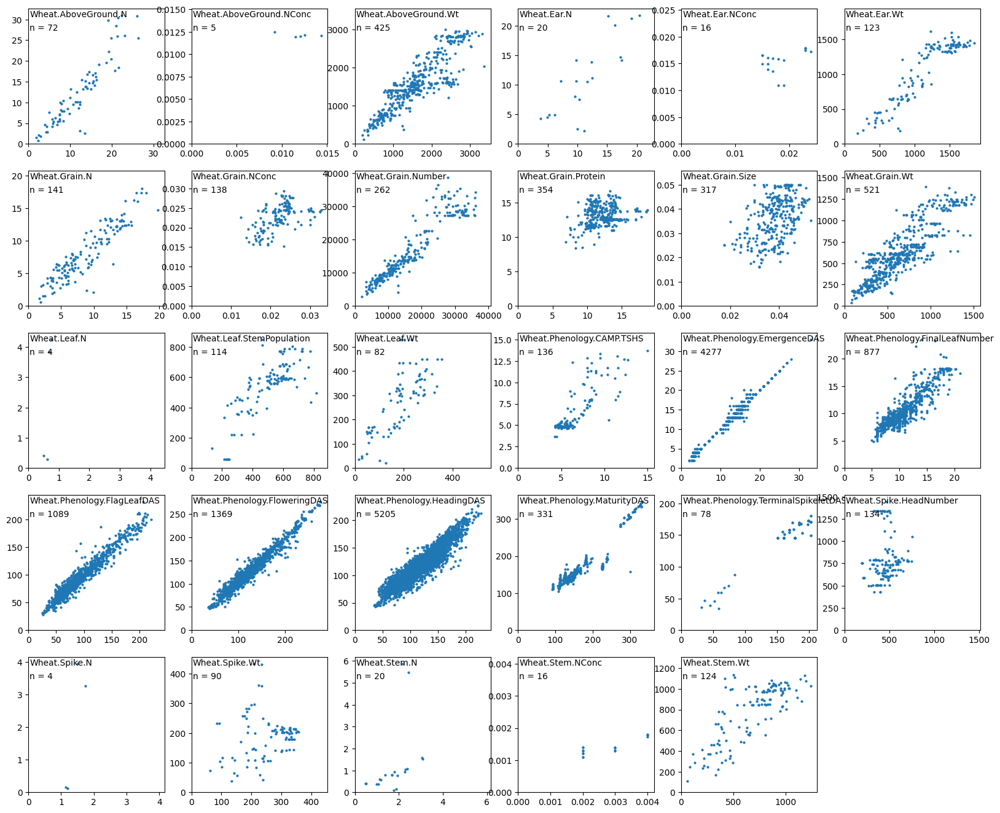

In [14]:
HarvGraphs =  plt.figure(figsize=(20,20))
pos=1
for var in HarvVars:
    ax = HarvGraphs.add_subplot(6,6,pos)
    obsPred = pd.DataFrame(HarvestObs.loc[:,var].dropna().copy())
    obsPred.columns = ['obs']
    obsPred.index = obsPred.index.get_level_values(0)
    for s in obsPred.index:
        try:
            obsPred.loc[s,'pred'] = HarvestPred.loc[s,var].values[0]
        except:
            obsPred.loc[s,'pred'] = np.nan
    obsPred.dropna(inplace=True)
    plt.plot(obsPred.obs,obsPred.pred,'o',ms = 2)
    plt.text(0.01,0.99,var,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
    n = len(obsPred.obs)
    plt.text(0.01,0.89,'n = '+ str(n),transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
    amax = 1
    if len(obsPred.pred.dropna())>0:
        axmax = max(obsPred.obs.max(),obsPred.pred.max())
    plt.ylim(0,axmax*1.05)
    plt.xlim(0,axmax*1.05)
    
    pos+=1

In [15]:
dailyObsIndices = ['Clock.Today',
                'Wheat.Phenology.CurrentStageName',
                'IWeather.Latitude',
                'IWeather.Longitude',
                'LocationInfo.Script.Country',
                'LocationInfo.Script.Region',
                'LocationInfo.Script.State',
                'Wheat.SowingData.Cultivar',
                'Experiment',
                'FolderName']

dailyObsVars = ['NDVIModel.Script.NDVI',
                'Wheat.AboveGround.N',
                'Wheat.AboveGround.NConc',
                'Wheat.AboveGround.Wt',
                'Wheat.Ear.N',
                'Wheat.Ear.NConc',
                'Wheat.Ear.Wt',
                'Wheat.Grain.N',
                'Wheat.Grain.NConc',
                'Wheat.Grain.Wt',
                'Wheat.Leaf.CoverGreen',
                'Wheat.Leaf.CoverTotal',
                'Wheat.Leaf.Dead.N',
                'Wheat.Leaf.Dead.NConc',
                'Wheat.Leaf.Dead.Wt',
                'Wheat.Leaf.Height',
                'Wheat.Leaf.LAI',
                'Wheat.Leaf.Live.N',
                'Wheat.Leaf.Live.NConc',
                'Wheat.Leaf.Live.StorageWt',
                'Wheat.Leaf.Live.Wt',
                'Wheat.Leaf.N',
                'Wheat.Leaf.SpecificAreaCanopy',
                'Wheat.Leaf.StemNumberPerPlant',
                'Wheat.Leaf.StemPopulation',
                'Wheat.Leaf.Wt',
                'Wheat.Phenology.HaunStage',
                'Wheat.Phenology.Zadok.Stage',
                'Wheat.Spike.N',
                'Wheat.Spike.NConc',
                'Wheat.Spike.Live.StorageWt',
                'Wheat.Spike.Wt',
                'Wheat.Stem.N',
                'Wheat.Stem.NConc',
                'Wheat.Stem.Live.StorageWt',
                'Wheat.Stem.Wt',
                '(Wheat.Leaf.Transpiration + ISoilWater.Es + MicroClimate.PrecipitationInterception)',
                'sum(Soil.Water.MM)',
                'Soil.Water.Volumetric(1)']

dailyObsIndicesAndVars = dailyObsIndices+dailyObsVars

DailyObs = Observed.loc[~Observed.loc[:,'Clock.Today'].isnull(),dailyObsIndicesAndVars]
DailyObs.dropna(axis=1,how="all",inplace=True)
DailyObs.dropna(axis=0,how="all",inplace=True)

In [16]:
IndexVars = ['Clock.Today',
'IWeather.MaxT',
'IWeather.MinT',
'IWeather.Radn',
'SimulationID',
'SimulationName',
'Wheat.DaysAfterSowing',
'Wheat.Phenology.AccumulatedTT',
'Wheat.Phenology.CurrentPhase.Name',
'Wheat.Phenology.CurrentStageName',
'Wheat.Phenology.Stage']

for iv in IndexVars:
    DailyObs.loc[:,iv] = DailyPred.reindex(DailyObs.index).loc[:,iv]
    
DailyResidules = DailyObs.copy()
for ov in dailyObsVars:
    DailyResidules.loc[:,ov] = DailyObs.loc[:,ov] - DailyPred.reindex(DailyObs.index).loc[:,ov]

In [17]:
#Make data frame with factor information for each simulation
FactorList = [ 'Experiment',
 'Canopy',
 'Cm',
 'Cultivar',
 'Cv',
 'Date',
 'Durat',
 'Fungicide',
 'Grazed',
 'Irr',
 'Irrig',
 'Mgmt',
 'N',
 'NRate',
 'Nit',
 'Nutrition',
 'P',
 'PGR',
 'Popn',
 'Removal',
 'RowSpace',
 'SD',
 'Seeds',
 'Soil',
 'Sow',
 'SowN',
 'Stubble',
 'TOS',
 'TopN',
 'Treat',
 'Treatment',
 'V',
 'Water']

Factors = HarvestPred.loc[:,FactorList].copy()
Factors.index = Factors.index.droplevel(1)
Factors.set_index('Experiment',append=True,inplace=True)
Factors=Factors.reorder_levels(['Experiment','SimulationName'])
Factors.sort_index(inplace=True)
CondensedFactors = pd.DataFrame(index = Factors.index,columns = ['fName1','fValue1'])
for s in Factors.index:
    fs = Factors.loc[s,:].dropna().to_dict()
    fCount = 1
    for key, value in fs.items():
        CondensedFactors.loc[s,'fName'+str(fCount)] = key
        CondensedFactors.loc[s,'fValue'+str(fCount)] = value
        fCount +=1
valueLabs = ['fValue1','fValue2','fValue3','fValue4']
indexLabs = ['fIndex1','fIndex2','fIndex3','fIndex4']
CondensedFactors.loc[:,indexLabs]=1

# put simulation names in as first factor level for sims that are not in a experiment
for e in Experiments:
    fValues1 = CondensedFactors.loc[e,'fValue1']
    if True in pd.isna(fValues1.values):
        CondensedFactors.loc[e,'fValue1'] = CondensedFactors.loc[e,:].index.values
        
#assign numeric index to each factor level
for e in Experiments:
    for v in valueLabs:
        fLevels = CondensedFactors.loc[e,v].drop_duplicates().values
        if False in pd.isna(fLevels):
            levelDic = dict(zip(fLevels,list(range(1,len(fLevels )+1))))
            CondensedFactors.loc[e,v.replace('Value','Index')] = [levelDic[x] for x in CondensedFactors.loc[e,v]]

In [18]:
def residualGraph(ind,var,gro,figsize = (20,10),legends=True):
    Graph = plt.figure(figsize=figsize)
    ax = Graph.add_subplot(1,1,1)
    plotSet = DailyResidules.dropna(subset=[ind,var]).loc[:,[ind,var,gro]]
    Groups = list(plotSet.Experiment.drop_duplicates().values)
    colPos = 1
    markerPos = 1
    for g in Groups:
        groupSet = plotSet.loc[plotSet.loc[:,gro] == g,:]
        SimsToGraph = list(groupSet.index.get_level_values(0).drop_duplicates())
        for s in SimsToGraph:
            data = DailyResidules.loc[s,[ind,var]].dropna()
            x = data.loc[:,ind]
            y = data.loc[:,var]
            plt.plot(x,y,Markers[markerPos]+'-',lw=1,ms=10,color = Colors[colPos],label=g)
        colPos +=1
        if colPos>8:
            colPos=1
            markerPos +=1
    plt.ylabel(var+" (Obs - Pred)")
    plt.xlabel(ind)
    if legends == True:
        GH.AddLegend(LegLoc=1,labelsize=12,Title='Experiment')
    plt.close("Graph")
def timeSeriesGraph(ind,var,gro,figsize = (20,20),legends=False,cols=6,yfix=True):
    Graph = plt.figure(figsize=figsize)
    plotSet = DailyResidules.dropna(subset=[ind,var]).loc[:,[ind,var,gro]]
    ymax = max(DailyObs.loc[:,var].max(),DailyPred.loc[:,var].max())*1.01
    Groups = list(plotSet.Experiment.drop_duplicates().values)
    colPos = 1
    Pos = 1
    rows = int(np.ceil(len(Groups)/cols))
    for g in Groups:
        markerPos = 1
        ax = Graph.add_subplot(rows,cols,Pos)
        groupSet = plotSet.loc[plotSet.loc[:,gro] == g,:]
        SimsToGraph = list(groupSet.index.get_level_values(0).drop_duplicates())
        for s in SimsToGraph:
            scol = Colors[CondensedFactors.loc[(g,s),'fIndex1']]
            slin = Lines[CondensedFactors.loc[(g,s),'fIndex2']]
            smar = Markers[CondensedFactors.loc[(g,s),'fIndex2']]
            obs = DailyObs.loc[s,[ind,var]].dropna()
            obsX = obs.loc[:,ind]
            obsY = obs.loc[:,var]
            plt.plot(obsX,obsY,smar,ms=5,color = scol,label=s.replace(g,''))
            pred = DailyPred.loc[s,[ind,var]].dropna()
            predX = pred.loc[:,ind].where( pred.loc[:,ind] > 1.0,np.nan)
            predY = pred.loc[:,var]
            plt.plot(predX,predY,slin,lw=1,color = scol)
            markerPos +=1
            if markerPos >12:
                markerPos = 1
        if yfix == True:
            plt.ylim(0,ymax)
        plt.text(0.01,0.99,g,horizontalalignment='left', verticalalignment='top', transform=ax.transAxes)
        Pos +=1
        colPos +=1
        if colPos>8:
            colPos=1
        plt.ylabel(var)
        if legends == True:
            GH.AddLegend(LegLoc=2,labelsize=12,Title='Experiment')
    plt.close("Graph")

def makeGraphs(var,height,yfix):
    residualGraph(ind = 'Wheat.Phenology.Stage',
              var = var,
              gro = 'Experiment',
              figsize = (20,5))
    timeSeriesGraph(ind = 'Wheat.Phenology.Stage',
                var = var,
                gro = 'Experiment',
                figsize = (20,height),yfix=yfix)

C:\Users\Cflhxb\AppData\Local\Temp\ipykernel_5192\873955913.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  Graph = plt.figure(figsize=figsize)


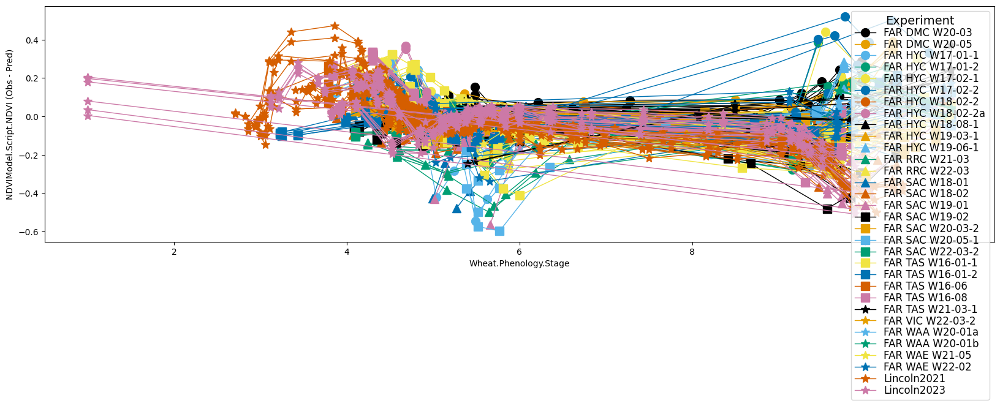

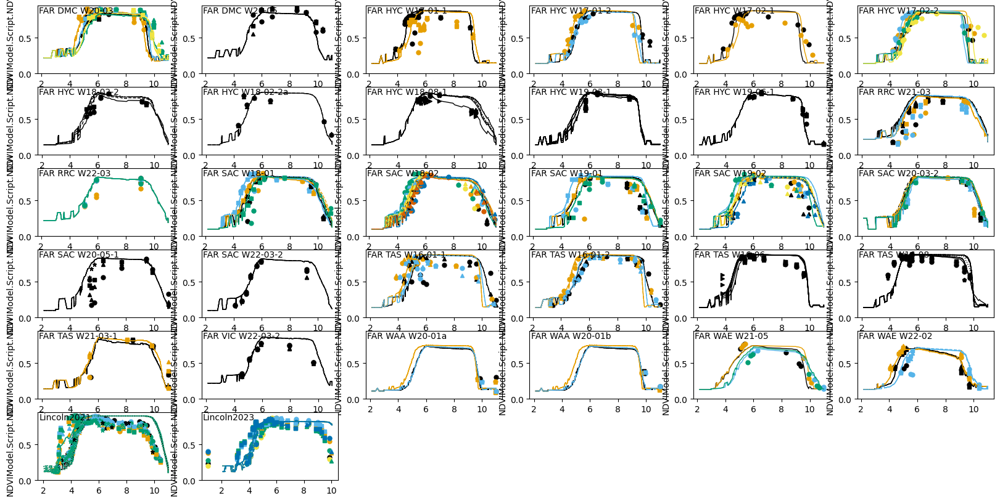

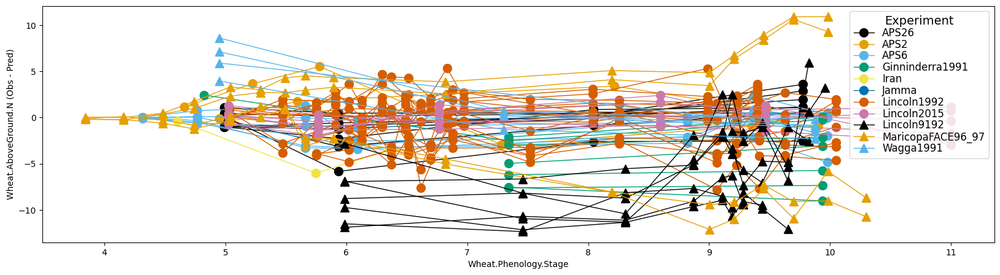

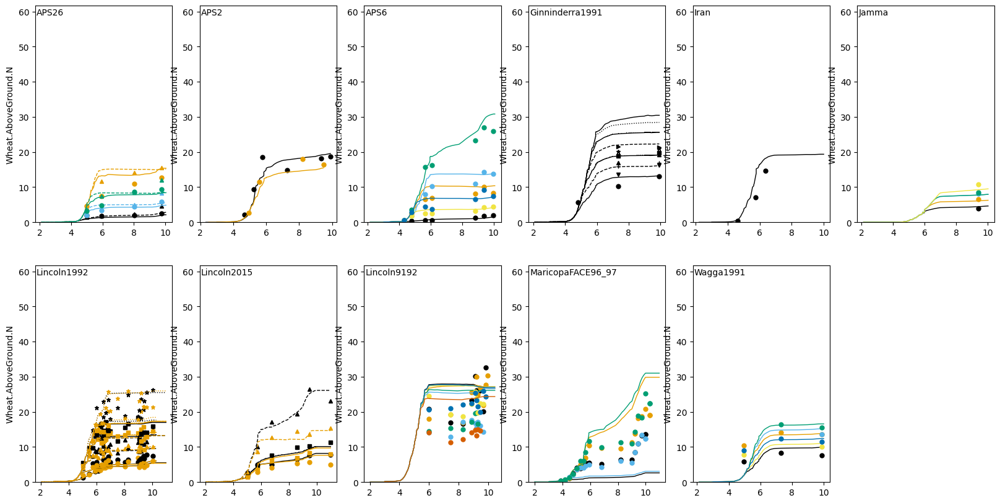

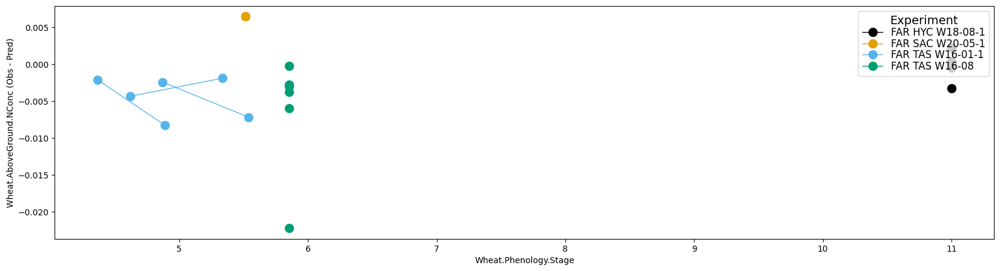

...

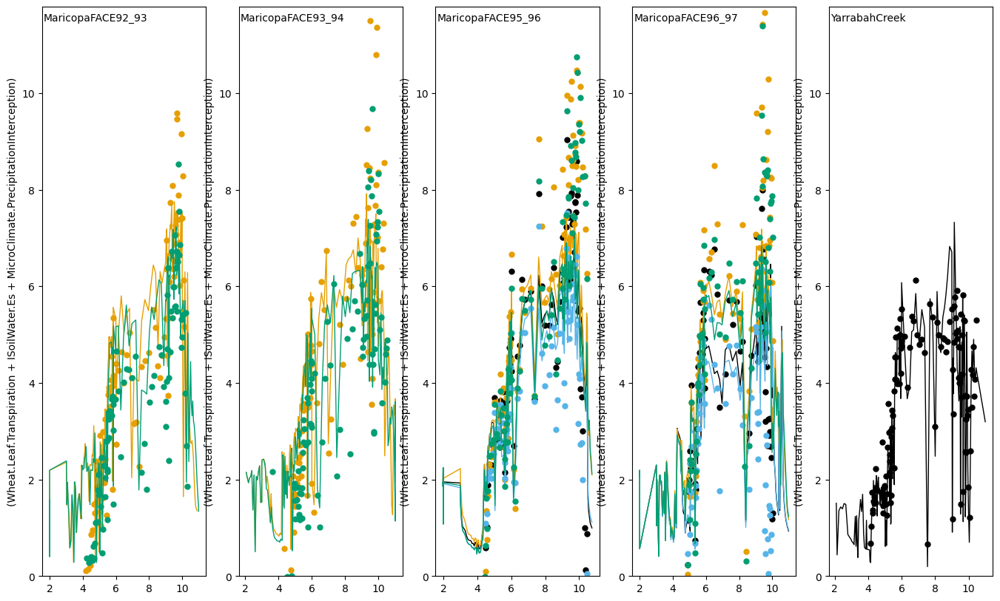

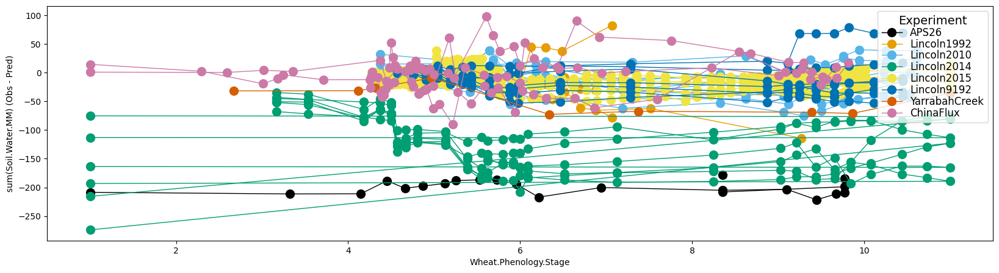

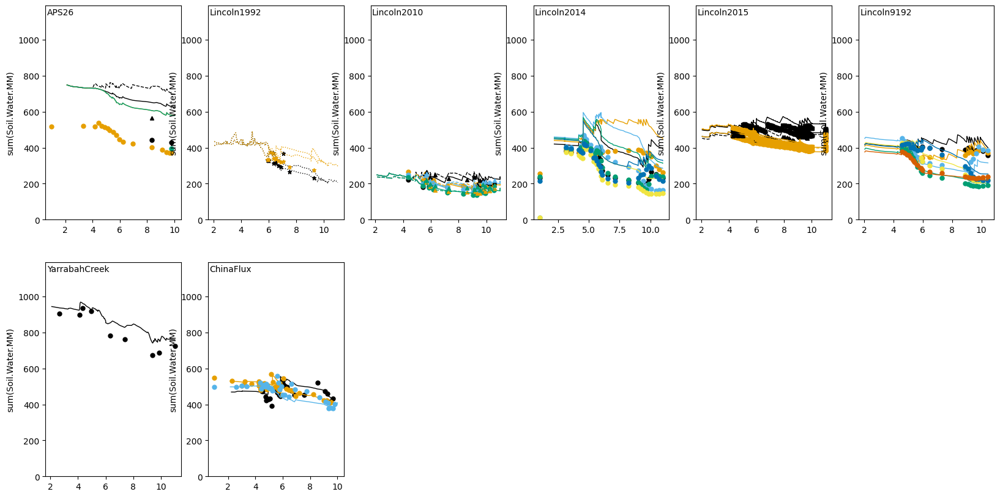

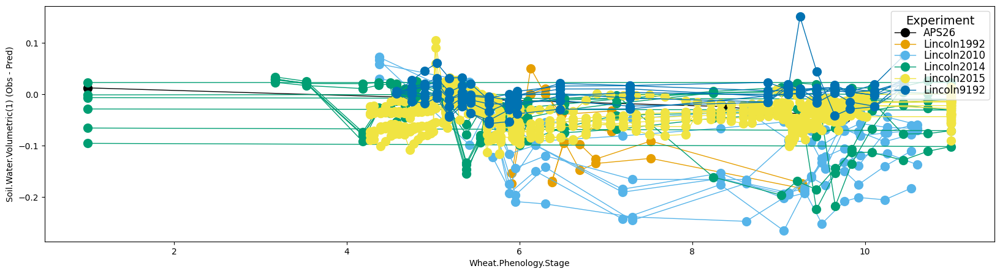

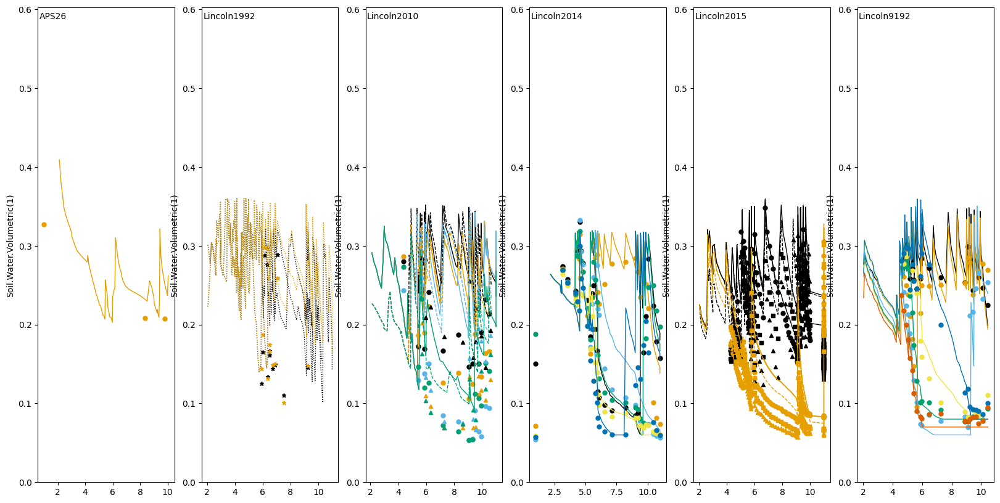

In [19]:
for var in dailyObsVars:
    try:
        makeGraphs(var,height = 10,yfix=True)
    except:
        do = 'Proceed'

In [20]:
Cultivars = list(HarvestObs.loc[:,"Wheat.SowingData.Cultivar"].drop_duplicates())
Cultivars.sort()

In [21]:
DevVars = ['Wheat.Phenology.FinalLeafNumber',
'Wheat.Phenology.FlagLeafDAS',
'Wheat.Phenology.HeadingDAS',
'Wheat.Phenology.FloweringDAS',
'Wheat.Phenology.MaturityDAS']

In [22]:
Cultivars

['',
 'Adv08_0008',
 'Amarok',
 'Ararat',
 'Axe',
 'Batavia',
 'Battenspring',
 'Battenwinter',
 'Beaufort',
 'Bennett',
 'Bolac',
 'Braewood',
 'Calingiri',
 'Catalina',
 'Cesario',
 'Claire',
 'Condo',
 'Conquest',
 'Crusader',
 'Crw247',
 'Crwt153',
 'Csirow002',
 'Csirow003',
 'Csirow005',
 'Csirow007',
 'Csirow011',
 'Csirow018',
 'Csirow021',
 'Csirow023',
 'Csirow027',
 'Csirow029',
 'Csirow073',
 'Csirow077',
 'Csirow087',
 'Csirow102',
 'Csirow105',
 'Cunningham',
 'Cutlass',
 'Dekan',
 'Derrimut',
 'Discovery',
 'Drysdale',
 'Eaglehawk',
 'Egret',
 'Ellison',
 'Emu_Rock',
 'Forrest',
 'Gamenya',
 'Gauntlet',
 'Gorgan',
 'Graham',
 'Gregory',
 'Grenade',
 'Gutha',
 'H45',
 'Har1685',
 'Hartog',
 'Hume',
 'Illabo',
 'Janz',
 'Kellalac',
 'Kerrin',
 'Keyu13',
 'Kittyhawk',
 'Konya',
 'Lancer',
 'Lang',
 'Lincoln',
 'Livingston',
 'Longsword',
 'Mace',
 'Mackellar',
 'Magenta',
 'Manning',
 'Matong',
 'Mccubbin',
 'Mercury',
 'Merinda',
 'Mitch',
 'Nighthawk',
 'Otane',
 'Ouyen',

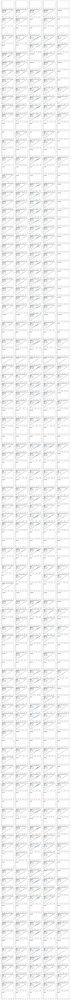

In [23]:
DevGraphs =  plt.figure(figsize=(20,300))
pos=1
for c in Cultivars:
    hpos = 1
    for var in DevVars:
        ax = DevGraphs.add_subplot(len(Cultivars),5,pos)
        cFilt = HarvestObs.loc[:,"Wheat.SowingData.Cultivar"] == c
        obsPred = pd.DataFrame(HarvestObs.loc[cFilt,var].dropna().copy())
        obsPred.columns = ['obs']
        obsPred.index = obsPred.index.get_level_values(0)
        for s in obsPred.index:
            try:
                obsPred.loc[s,'pred'] = HarvestPred.loc[s,var].values[0]
            except:
                obsPred.loc[s,'pred'] = np.nan
        obsPred.dropna(inplace=True)
        plt.text(0.01,0.89,c,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top',weight='bold')
        if (len(obsPred.obs)>0):
            plt.plot(obsPred.obs,obsPred.pred,'o',ms = 2)
            plt.text(0.01,0.99,var,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
            amax = 1
            if len(obsPred.pred.dropna())>2:
                RegStats = MUte.MathUtilities.CalcRegressionStats('',obsPred.pred,obsPred.obs)
                fitR2 = '$RMSE$ = ' + str(RegStats.RMSE)[:4]\
                  + '\n$Bias$ = ' + str(RegStats.ME)[:4] \
                  + '\n$NSE$ = ' + str(RegStats.NSE)[:4]\
                  #+ '\n$R^2$ = ' + str(RegStats.R2)[:4]
                plt.text(0.01,0.79,fitR2,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
                n = len(obsPred.obs)
                plt.text(0.01,0.39,'n = '+ str(n),transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
                if len(obsPred.pred.dropna())>0:
                    axmax = max(obsPred.obs.max(),obsPred.pred.max())
            plt.ylim(0,axmax*1.05)
            plt.xlim(0,axmax*1.05)
            plt.plot([0,axmax],[0,axmax],'-',color='k')

        pos+=1